# **Data Augmentation With Library imgaug.augmenters**

In [64]:
import imgaug.augmenters as iaa
import cv2
from google.colab.patches import cv2_imshow
import glob

**Load Images**

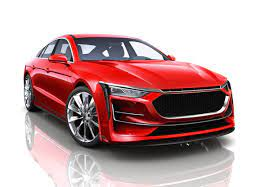

(187, 270, 3)

In [165]:
img = cv2.imread("/data/car_1.jpg")
cv2_imshow(img)

img.shape

In [166]:
from zipfile import ZipFile
file_path = "/data/car.zip"

with ZipFile(file_path, 'r') as zip:
  zip.extractall('./')
  zip.close()

In [167]:
image_paths = glob.glob("/data/car/*")

print(image_paths)

[]


In [69]:
images = []
for img_path in image_paths:
  img = cv2.imread(img_path)
  img = cv2.resize(img, (187,270))
  #cv2_imshow(img)
  images.append(img)

**Image Augmentation**

In [70]:
augmentation = iaa.Sequential([
      #iaa.geometric.Affine(rotate=(-45,45)) # Rotation random between -30 and 30 degree
      #iaa.Rot90(1,keep_size=False)     # Rotation 90 degree    
      
      # Flip
      iaa.Fliplr(0.5),  # horizontally flip 50% of the images
      iaa.Flipud(0.5),  # vertical flip

      # Affine
      iaa.Affine(translate_percent= {"x" : (-0.2, 0.2), "y": (-0.3, 0.3)},
                 rotate=(-30, 30),
                 scale=(0.5, 1.5)),
      # Multiply
      iaa.Multiply((0.5,1.5)),

      # LinearContrast
      iaa.LinearContrast((0.6,1.5)),

      # GaussianBlur
      iaa.Sometimes(0.5,
                    iaa.GaussianBlur((0,3.0)) # # blur images with a sigma of 0 to 3.0
                    )
])

augmented_images = augmentation(images = images)

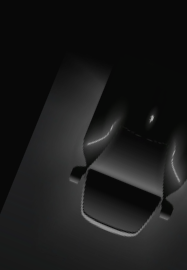

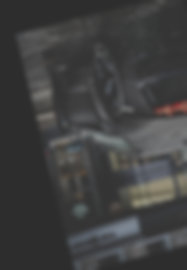

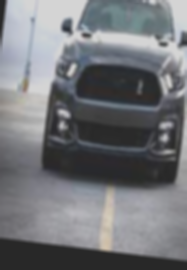

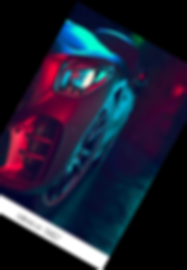

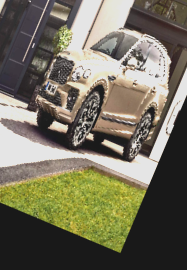

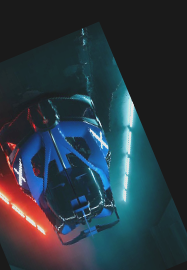

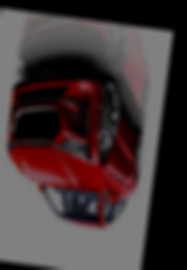

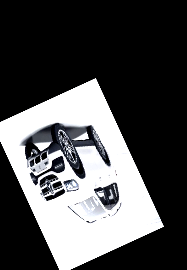

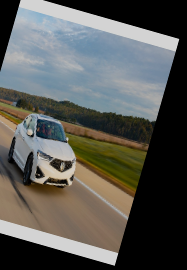

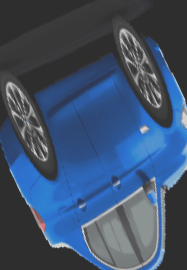

In [71]:
for img in augmented_images:
  cv2_imshow(img)



---



# **Data Augmentation With Tensorflow**

Manual image manipulation and augmentation using *tf.image*

In [157]:
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-kykrma9g
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-kykrma9g
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=179891 sha256=1b3c63c5b7a15ee5cd4aec856b8605e9ff3f8202398de236fce2d5586e95502e
  Stored in directory: /tmp/pip-ephem-wheel-cache-3y4zlzas/wheels/cc/c4/d8/5341e93b6376c5c929c49469fce21155eb69cef1a4da4ce32c
Successfully built tensorflow-docs


In [160]:
import tensorflow as tf
from tensorflow.keras.datasets import mnist
from tensorflow.keras import layers
import tensorflow_datasets as tfds
import tensorflow_docs as tfdocs
import tensorflow_docs.plots

import numpy as np
import matplotlib.pyplot as plt
import PIL.Image
from datetime import datetime as dt

In [79]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


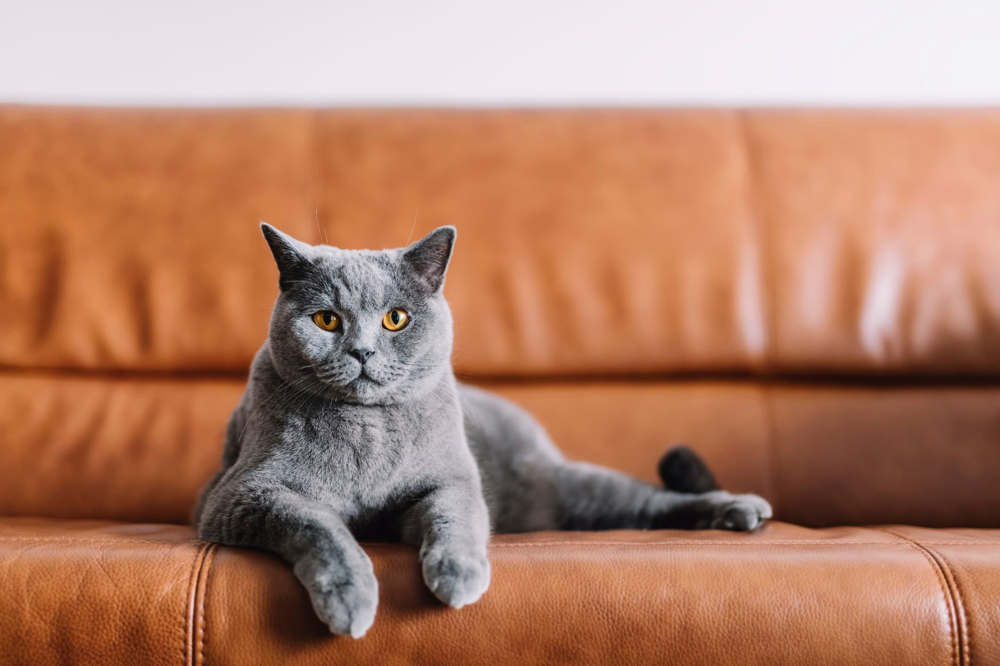

In [168]:
img_path = '/data/cat_test.jpg'
img = PIL.Image.open(img_path)
img

In [81]:
img.size

(2121, 1414)

In [87]:
img_string = tf.io.read_file(img_path)
image = tf.image.decode_jpeg(img_string, channels =3)
image.shape

TensorShape([1414, 2121, 3])

**TensorBoard**

L'image doit être de rang 4 pour être affichée dans TensorBoard (batch_size, height, width, channels)

In [88]:
img = tf.expand_dims(image, 0)
img.shape

TensorShape([1, 1414, 2121, 3])

In [89]:
# Clear out any prior log data.
!rm -rf logs

logdir = 'logs/train_data/' + dt.now().strftime('%Y%m%d-%H%M%S')
file_writer = tf.summary.create_file_writer(logdir)

with file_writer.as_default():
  tf.summary.image('Training_data', img, step=0)

In [90]:
%tensorboard --logdir logs/train_data

Reusing TensorBoard on port 6006 (pid 434), started 0:26:53 ago. (Use '!kill 434' to kill it.)

<IPython.core.display.Javascript object>

In [91]:
def visualize(ori_img, aug_img):
  fig = plt.figure()
  plt.subplot(1,2,1)
  plt.title('Original image')
  plt.imshow(ori_img)

  plt.subplot(1,2,2)
  plt.title('Augmented image')
  plt.imshow(aug_img)

**Flip Image**

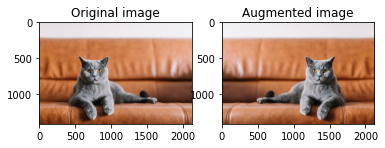

In [92]:
flipped = tf.image.flip_left_right(image)

visualize(image, flipped)

Display in TensorBoard

In [93]:
with file_writer.as_default():
  tf.summary.image("Original image", tf.expand_dims(image, 0), step=0)
  tf.summary.image("Augmented image", tf.expand_dims(flipped, 0), step=0)

In [94]:
%tensorboard --logdir logs/train_data

Reusing TensorBoard on port 6006 (pid 434), started 0:27:55 ago. (Use '!kill 434' to kill it.)

<IPython.core.display.Javascript object>

**Grayscale Image**

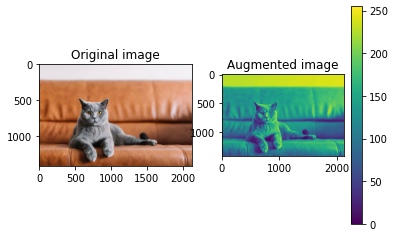

In [95]:
gray_scaled = tf.image.rgb_to_grayscale(image)
visualize(image, tf.squeeze(gray_scaled))
plt.colorbar()

**Saturate Image**

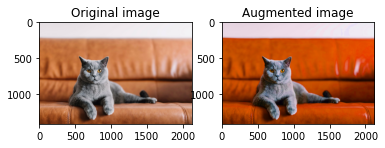

In [97]:
saturated = tf.image.adjust_saturation(image,3)  # Similar with multiply in iaa
visualize(image, saturated)

**Center Crop Image**

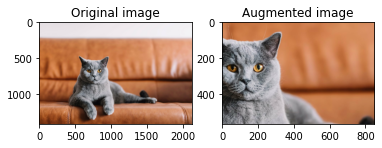

In [102]:
cropped = tf.image.central_crop(image, central_fraction=0.4)
visualize(image,cropped)

**Rotate Image**

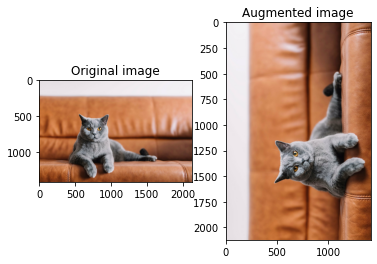

In [103]:
rotated = tf.image.rot90(image)
visualize(image, rotated)

**Change Image Brightness**

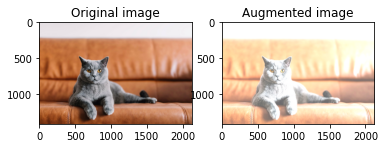

In [114]:
changed_bright = tf.image.adjust_brightness(image, 0.4)
visualize(image, changed_bright)

# **Augment Dataset And Train Model**

In [124]:
image_path = tf.keras.utils.get_file("cat.jpg", "https://storage.googleapis.com/download.tensorflow.org/example_images/320px-Felis_catus-cat_on_snow.jpg")
img = PIL.Image.open(image_path)

img_string = tf.io.read_file(image_path)
image_test = tf.image.decode_jpeg(img_string, channels =3)
image_test.shape


TensorShape([213, 320, 3])

In [109]:
dataset, info = tfds.load('mnist', as_supervised=True, with_info=True)
train_dataset, test_dataset = dataset['train'], dataset['test']

nb_train_example = info.splits["train"].num_examples

print("Information : ", info)
print("Number train examples :" , nb_train_example)

Information :  tfds.core.DatasetInfo(
    name='mnist',
    version=3.0.1,
    description='The MNIST database of handwritten digits.',
    homepage='http://yann.lecun.com/exdb/mnist/',
    features=FeaturesDict({
        'image': Image(shape=(28, 28, 1), dtype=tf.uint8),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=10),
    }),
    total_num_examples=70000,
    splits={
        'test': 10000,
        'train': 60000,
    },
    supervised_keys=('image', 'label'),
    citation="""@article{lecun2010mnist,
      title={MNIST handwritten digit database},
      author={LeCun, Yann and Cortes, Corinna and Burges, CJ},
      journal={ATT Labs [Online]. Available: http://yann.lecun.com/exdb/mnist},
      volume={2},
      year={2010}
    }""",
    redistribution_info=,
)

Number train examples : 60000


In [148]:
def convert(img, label):
  return tf.image.convert_image_dtype(img,dtype=tf.float32) , label# normalize image to [0,1]

In [147]:
def augment(image, label):
  image = tf.image.convert_image_dtype(image, tf.float32) # Cast and normalize
  image = tf.image.resize_with_crop_or_pad(image, 34,34) # Add 6 pixels of padding
  image = tf.image.random_crop(image, size=[28,28,1]) # Random crop
  image = tf.image.random_brightness(image, max_delta=0.5) # Random brightness

  return image, label

In [149]:
BATCH_SIZE = 64
NUM_EXAMPLES = 2048
AUTOTUNE = tf.data.experimental.AUTOTUNE

Create augmentation dataset

In [151]:
augmented_train_batch = (
    train_dataset.take(NUM_EXAMPLES)
    .cache()
    .shuffle(nb_train_example // 4)
    .map(augment, num_parallel_calls=AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

Add a no_augmented for comparison

In [152]:
no_augmented_train_batch = (
    train_dataset.take(NUM_EXAMPLES)
    .cache()
    .shuffle(nb_train_example // 4)
    .map(convert, num_parallel_calls=AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

Validation set

In [153]:
validation_batch = (
    test_dataset
    .map(convert, num_parallel_calls=AUTOTUNE)
    .batch(2*BATCH_SIZE)
)

**Create and Compile Model**

In [154]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)

def build_model():
  model = tf.keras.Sequential([
        layers.Flatten(input_shape=(28,28,1)),
        layers.Dense(4096, activation='relu'),
        layers.Dense(2048, activation='relu'),
        layers.Dense(10)
  ])

  model.compile(loss=tf.losses.SparseCategoricalCrossentropy(from_logits=True),
                optimizer = 'adam',
                metrics = ['accuracy'])

  return model

Model without augmentation

In [155]:
model_no_aug = build_model()

no_aug_history = model_no_aug.fit(no_augmented_train_batch, validation_data=validation_batch, epochs=50, callbacks=[tensorboard_callback])

Epoch 1/50
32/32 [==============================] - 19s 570ms/step - loss: 0.7459 - accuracy: 0.7573 - val_loss: 0.3891 - val_accuracy: 0.8760
Epoch 2/50
32/32 [==============================] - 12s 372ms/step - loss: 0.1683 - accuracy: 0.9419 - val_loss: 0.2580 - val_accuracy: 0.9210
Epoch 3/50
32/32 [==============================] - 30s 954ms/step - loss: 0.0602 - accuracy: 0.9829 - val_loss: 0.2861 - val_accuracy: 0.9215
Epoch 4/50
32/32 [==============================] - 11s 361ms/step - loss: 0.0327 - accuracy: 0.9912 - val_loss: 0.2707 - val_accuracy: 0.9310
Epoch 5/50
32/32 [==============================] - 10s 310ms/step - loss: 0.0325 - accuracy: 0.9883 - val_loss: 0.3404 - val_accuracy: 0.9184
Epoch 6/50
32/32 [==============================] - 9s 297ms/step - loss: 0.0537 - accuracy: 0.9800 - val_loss: 0.3953 - val_accuracy: 0.9121
Epoch 7/50
32/32 [==============================] - 10s 310ms/step - loss: 0.0259 - accuracy: 0.9941 - val_loss: 0.3705 - val_accuracy: 0.9230


Model with augmentation

In [156]:
model_with_aug = build_model()

aug_history = model_no_aug.fit(augmented_train_batch, validation_data=validation_batch, epochs=50, callbacks=[tensorboard_callback])

Epoch 1/50
32/32 [==============================] - 17s 543ms/step - loss: 4.8498 - accuracy: 0.2988 - val_loss: 1.1322 - val_accuracy: 0.6287
Epoch 2/50
32/32 [==============================] - 18s 581ms/step - loss: 1.6924 - accuracy: 0.4512 - val_loss: 0.7514 - val_accuracy: 0.7824
Epoch 3/50
32/32 [==============================] - 11s 342ms/step - loss: 1.1357 - accuracy: 0.6279 - val_loss: 0.4673 - val_accuracy: 0.8615
Epoch 4/50
32/32 [==============================] - 9s 298ms/step - loss: 0.8317 - accuracy: 0.7329 - val_loss: 0.3340 - val_accuracy: 0.9004
Epoch 5/50
32/32 [==============================] - 9s 297ms/step - loss: 0.6594 - accuracy: 0.7881 - val_loss: 0.2918 - val_accuracy: 0.9178
Epoch 6/50
32/32 [==============================] - 9s 297ms/step - loss: 0.6254 - accuracy: 0.7974 - val_loss: 0.3000 - val_accuracy: 0.9060
Epoch 7/50
32/32 [==============================] - 9s 297ms/step - loss: 0.4862 - accuracy: 0.8452 - val_loss: 0.2449 - val_accuracy: 0.9220
Epo

**Conclusion**

Plot Accuracy

(0.5, 1.0)

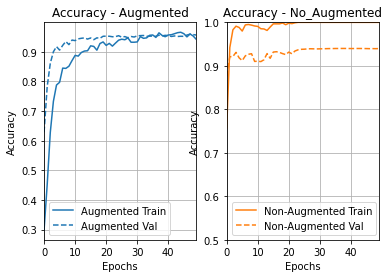

In [163]:
plotter = tfdocs.plots.HistoryPlotter()
plt.subplot(1,2,1)
plotter.plot({"Augmented": aug_history}, metric = "accuracy")
plt.title("Accuracy - Augmented")

plt.subplot(1,2,2)
plotter.plot({ "Non-Augmented": no_aug_history}, metric = "accuracy")
plt.title("Accuracy - No_Augmented")

plt.ylim([0.5,1])

Plot Loss

(0.0, 1.0)

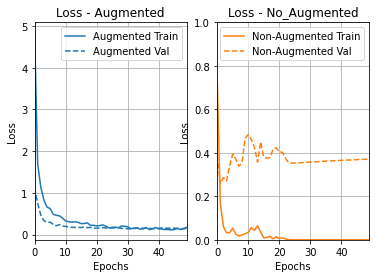

In [164]:
plt.subplot(1,2,1)
plotter.plot({"Augmented": aug_history}, metric = "loss")
plt.title("Loss - Augmented")

plt.subplot(1,2,2)
plotter.plot({ "Non-Augmented": no_aug_history}, metric = "loss")
plt.title("Loss - No_Augmented")
plt.ylim([0,1])

As we can see, non-augmented model is obviously in the overfitting.

The augmented model, is still training correctly not overfitting.